In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import shutil
import cv2
import os
from tqdm import tqdm
import random

random.seed(42)

In [2]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.86 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6170.1/8062.4 GB disk)


In [4]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolov8s.yaml")

# Train the model
results = model.train(data="/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml", 
                      epochs=100,
                      patience=10,
                      imgsz=640,
                      pretrained=False,
                      # batch=32,
                      # optimizer='AdamW',
                      # lr0=0.001,
                      # momentum=0.9,
                      )

Ultralytics 8.3.86 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml, epochs=100, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_label

100%|██████████| 755k/755k [00:00<00:00, 22.4MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 109MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/train/labels... 1740 images, 442 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:03<00:00, 458.18it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/val/labels... 217 images, 55 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:00<00:00, 468.56it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/val is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.78G      3.486      5.575      3.926         14        640: 100%|██████████| 109/109 [00:28<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.33it/s]


                   all        217        163   0.000413      0.228    0.00525    0.00155

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      3.72G      2.645      4.061      2.979         12        640: 100%|██████████| 109/109 [00:26<00:00,  4.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        217        163      0.115      0.187     0.0602     0.0192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      3.77G      2.361       3.14      2.603         12        640: 100%|██████████| 109/109 [00:27<00:00,  4.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.85it/s]


                   all        217        163      0.482      0.313      0.177     0.0601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      3.73G      2.256      2.719      2.504          8        640: 100%|██████████| 109/109 [00:27<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        217        163      0.257      0.301      0.251      0.111



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      3.76G      2.143      2.327      2.387         22        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.86it/s]

                   all        217        163      0.548      0.447      0.486      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      3.76G      2.116      2.094       2.38         20        640: 100%|██████████| 109/109 [00:29<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.558      0.487       0.53      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      3.76G      2.024      2.023      2.284         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.96it/s]

                   all        217        163       0.54      0.598      0.574       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      3.58G      2.025       1.94      2.296         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.99it/s]

                   all        217        163      0.553      0.499       0.53      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      3.75G       1.97      1.854      2.235         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.674      0.586      0.635      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100       3.6G      1.943      1.744      2.194         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.89it/s]

                   all        217        163      0.606      0.628      0.659       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      3.74G      1.927      1.759      2.195         18        640: 100%|██████████| 109/109 [00:29<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]

                   all        217        163      0.635      0.588      0.681      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      3.73G      1.925      1.662      2.182         21        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.93it/s]

                   all        217        163      0.674      0.637      0.692      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      3.78G      1.896      1.671      2.154         10        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.94it/s]

                   all        217        163      0.656      0.635      0.729      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      3.75G      1.876      1.594      2.122         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163      0.706      0.716       0.79      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      3.74G      1.857      1.584      2.097         20        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.88it/s]

                   all        217        163      0.727      0.698      0.741       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      3.72G      1.844      1.547      2.088         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.98it/s]

                   all        217        163      0.691       0.66      0.743       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      3.62G      1.869      1.533      2.104         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.94it/s]

                   all        217        163      0.816      0.628      0.747      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      3.75G      1.861      1.528      2.096         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.89it/s]

                   all        217        163      0.606      0.423      0.438      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      3.76G      1.791      1.456      2.035         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.91it/s]

                   all        217        163      0.681      0.558      0.615        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      3.72G      1.832       1.45      2.067         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        217        163      0.672      0.733      0.723      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      3.61G      1.804      1.429      2.037         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        217        163      0.748      0.704      0.783      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      3.75G      1.764      1.354      2.006          7        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.784      0.743      0.819      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100       3.6G      1.742      1.371      2.015         10        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163        0.7      0.706      0.732      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      3.72G      1.748      1.327      2.001         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.786      0.698      0.759      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      3.76G      1.778      1.362      2.021         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.91it/s]

                   all        217        163      0.709      0.659      0.722       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100       3.6G      1.722      1.314      1.998         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.88it/s]

                   all        217        163      0.744      0.758      0.789      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      3.75G      1.742      1.343      2.017         10        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        217        163      0.783      0.751       0.83      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      3.73G      1.706      1.274      1.947         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.98it/s]

                   all        217        163      0.751      0.744       0.81      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      3.75G       1.74      1.254      1.995         17        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163      0.763      0.772      0.826      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      3.75G      1.725      1.276       1.96         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.865      0.703      0.837      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      3.74G      1.713      1.265      1.972         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.05it/s]

                   all        217        163      0.815      0.794      0.848      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      3.72G      1.742      1.271      1.973         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        217        163      0.745      0.779      0.829      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      3.61G      1.669      1.176      1.905         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.90it/s]

                   all        217        163      0.765      0.839      0.853      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      3.75G      1.699      1.183      1.946         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        217        163      0.718      0.717      0.776      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      3.74G       1.68      1.192      1.931         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]

                   all        217        163      0.783      0.765      0.866      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      3.72G      1.692      1.172      1.972         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163      0.766      0.797      0.862      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      3.61G       1.68      1.148      1.914         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.00it/s]

                   all        217        163      0.785      0.766      0.845      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       3.6G      1.666      1.168      1.943         21        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.98it/s]

                   all        217        163      0.813      0.735      0.817      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      3.75G      1.639      1.164      1.923          8        640: 100%|██████████| 109/109 [00:29<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.92it/s]

                   all        217        163      0.705      0.749      0.788      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      3.72G      1.669      1.148      1.912         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.96it/s]

                   all        217        163      0.842      0.804      0.882      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      3.76G      1.624      1.105       1.89          6        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.93it/s]

                   all        217        163      0.823      0.752      0.848      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      3.75G      1.635      1.106      1.908         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]

                   all        217        163      0.767      0.821       0.88      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      3.76G      1.632      1.072      1.885         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]

                   all        217        163      0.811      0.721      0.826      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      3.72G      1.606      1.068       1.86         18        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.99it/s]

                   all        217        163      0.718      0.782      0.837       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      3.61G      1.611      1.082      1.887         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]

                   all        217        163      0.766      0.781      0.847      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100       3.6G      1.611       1.06      1.879         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.91it/s]

                   all        217        163      0.834       0.78      0.867      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100       3.6G      1.615      1.073      1.906         17        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.04it/s]

                   all        217        163      0.767      0.646      0.736      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      3.72G      1.605       1.08      1.862         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        217        163      0.783       0.78      0.843      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      3.61G      1.585      1.019      1.837         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.99it/s]

                   all        217        163      0.809      0.822      0.865      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      3.75G      1.534      0.983      1.817         20        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        217        163      0.771      0.812      0.866      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      3.75G       1.55     0.9844      1.833         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.12it/s]

                   all        217        163      0.834      0.811        0.9      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      3.72G      1.542     0.9941      1.817         19        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.00it/s]

                   all        217        163      0.829      0.807      0.879      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      3.76G      1.566     0.9631      1.822          9        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.98it/s]

                   all        217        163      0.833      0.811      0.872      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      3.76G      1.534     0.9486      1.834         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        217        163      0.858      0.829       0.89      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      3.76G      1.532     0.9435      1.806         21        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.00it/s]

                   all        217        163      0.868      0.837      0.914      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      3.72G       1.53      0.942      1.821         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.05it/s]

                   all        217        163      0.876      0.805      0.906      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      3.76G      1.514     0.9193      1.798         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.96it/s]

                   all        217        163      0.808      0.849      0.883       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      3.61G      1.514     0.9265      1.772         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.96it/s]

                   all        217        163      0.853      0.866      0.894      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      3.75G      1.521      0.897      1.786         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.00it/s]

                   all        217        163      0.722      0.867      0.874      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      3.72G       1.52     0.8923      1.812         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        217        163      0.828      0.836      0.889      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      3.61G      1.507     0.9015      1.792         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]

                   all        217        163      0.853      0.882      0.914      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      3.75G      1.472     0.8739      1.771         24        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        217        163      0.823      0.851      0.895      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      3.74G      1.477     0.8849      1.773          8        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.93it/s]

                   all        217        163       0.84      0.832      0.901      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      3.72G      1.512     0.9059      1.789         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.97it/s]

                   all        217        163      0.878      0.849      0.913      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      3.75G       1.48     0.8739      1.781         18        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.08it/s]

                   all        217        163      0.831      0.859      0.898      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      3.61G      1.488     0.8665      1.792         13        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.00it/s]

                   all        217        163      0.864      0.865      0.907      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100       3.6G      1.447      0.865      1.769         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.11it/s]

                   all        217        163      0.897      0.787      0.899      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      3.73G      1.462     0.8947      1.747         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.93it/s]

                   all        217        163      0.784       0.91      0.921      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      3.61G       1.45     0.8711      1.758          8        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.01it/s]

                   all        217        163       0.81      0.847      0.902      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100       3.6G      1.435     0.8334      1.738         19        640: 100%|██████████| 109/109 [00:29<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]

                   all        217        163      0.904      0.846      0.915      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      3.76G      1.459     0.8341       1.75         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.99it/s]

                   all        217        163       0.84       0.87      0.919      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      3.58G      1.417     0.8438      1.717         20        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.15it/s]

                   all        217        163      0.865       0.87      0.911      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      3.76G      1.402     0.7899      1.722         14        640: 100%|██████████| 109/109 [00:29<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  3.95it/s]

                   all        217        163      0.885       0.86       0.91      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100       3.6G      1.391     0.8042      1.693         11        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        217        163      0.866      0.847      0.917      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      3.59G      1.403     0.8156       1.72         18        640: 100%|██████████| 109/109 [00:29<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]

                   all        217        163      0.903      0.822      0.918      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      3.72G      1.394     0.7887      1.688         23        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.09it/s]

                   all        217        163      0.905      0.848      0.914      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      3.61G       1.39     0.7935       1.69         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]

                   all        217        163      0.839      0.877      0.912      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      3.75G      1.387      0.779      1.699         17        640: 100%|██████████| 109/109 [00:29<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.10it/s]

                   all        217        163      0.911      0.836      0.912      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      3.75G      1.371     0.8023      1.697         12        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.13it/s]

                   all        217        163      0.907      0.863      0.914      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      3.72G      1.355     0.7645      1.661         15        640: 100%|██████████| 109/109 [00:29<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]

                   all        217        163      0.893      0.838      0.922      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      3.61G      1.372     0.7808      1.704         16        640: 100%|██████████| 109/109 [00:29<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.07it/s]

                   all        217        163      0.889      0.824      0.906       0.48
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 71, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



81 epochs completed in 0.717 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8s summary (fused): 72 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  3.00it/s]


                   all        217        163      0.841       0.87      0.919      0.513
             pituitary         62         63       0.89      0.901      0.942      0.525
            meningioma         55         55      0.847      0.909      0.968      0.564
                glioma         45         45      0.784        0.8      0.846      0.449


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 4.9ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/train


In [5]:
val_results = model.val(split='test')

Ultralytics 8.3.86 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8s summary (fused): 72 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/test/labels... 218 images, 55 backgrounds, 0 corrupt: 100%|██████████| 218/218 [00:00<00:00, 483.13it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  4.10it/s]


                   all        218        164      0.897      0.821      0.875      0.476
             pituitary         62         62      0.918      0.935      0.958      0.462
            meningioma         55         55      0.964      0.909      0.986      0.608
                glioma         46         47      0.809      0.617      0.683      0.358


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 1.4ms preprocess, 9.5ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/train2


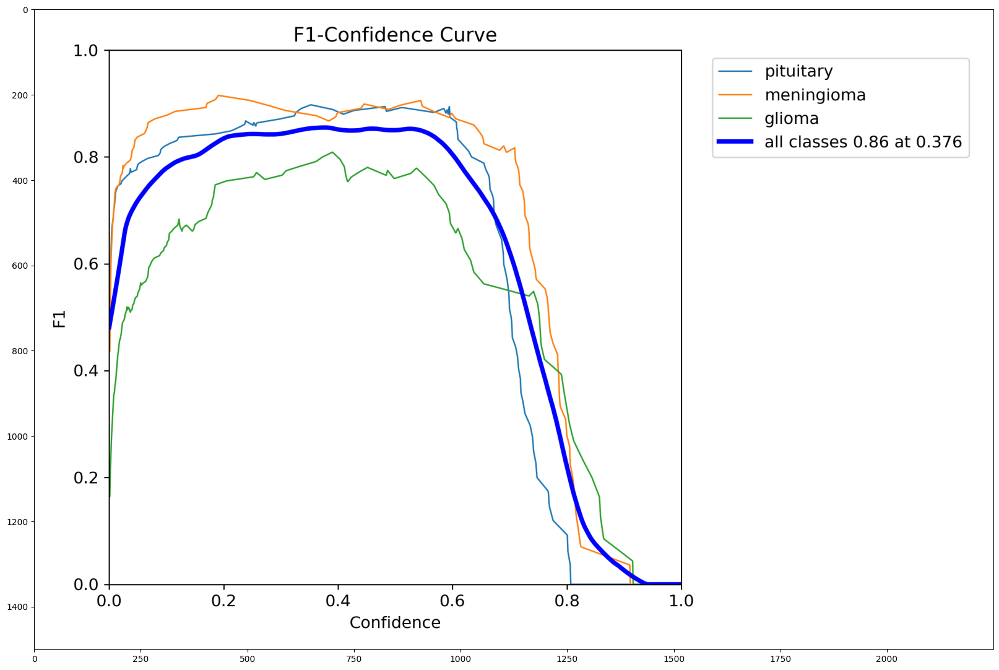

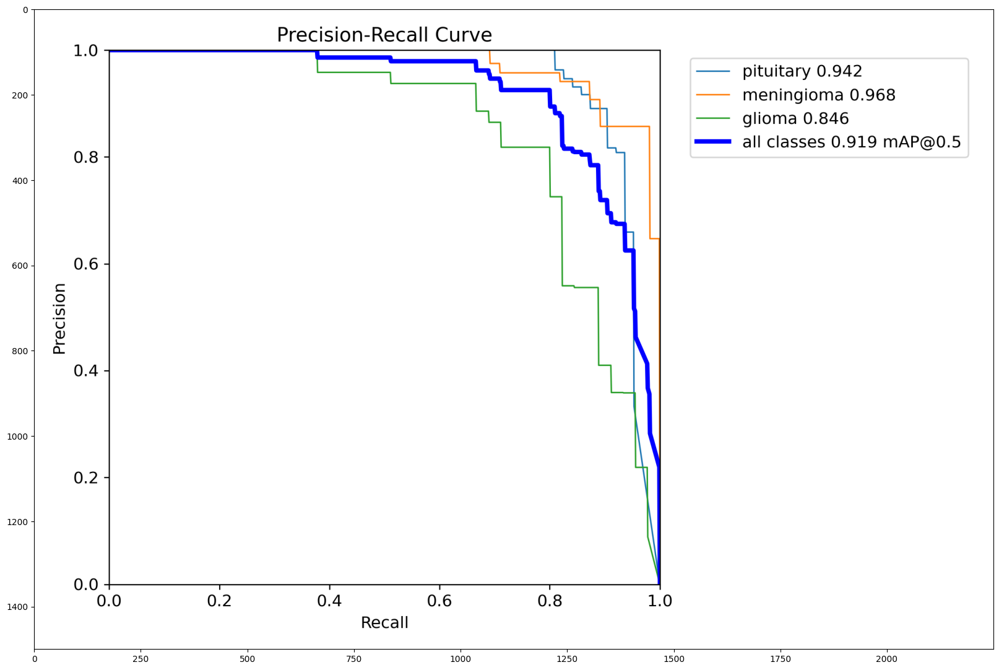

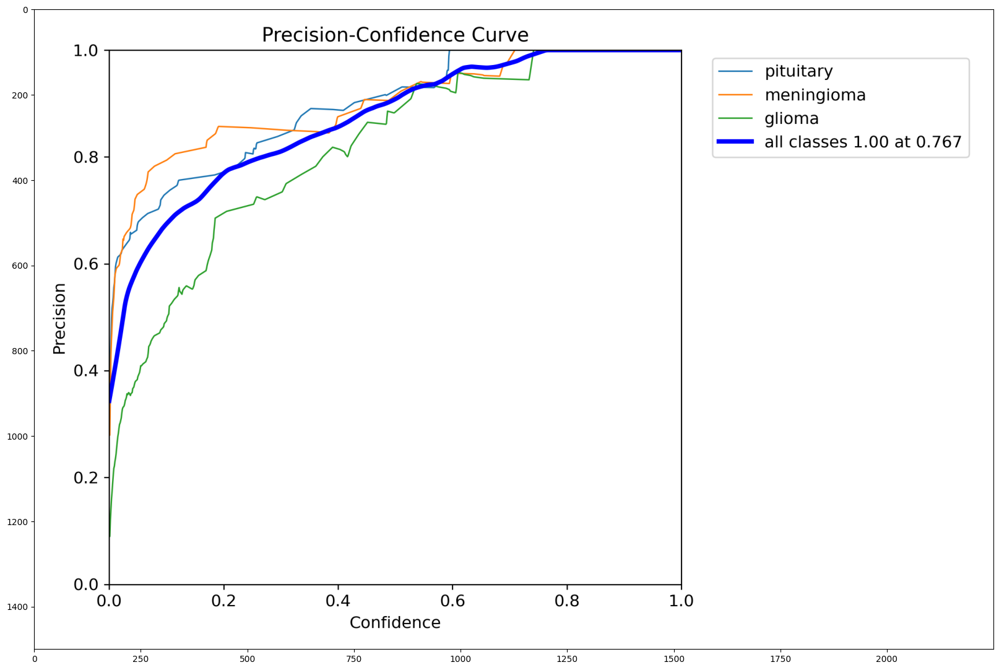

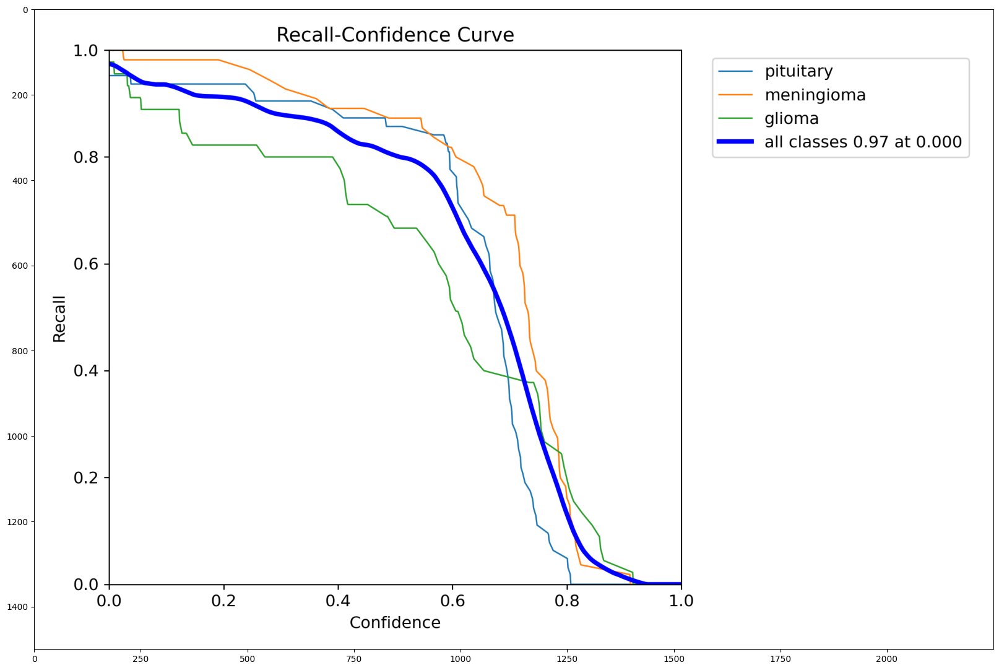

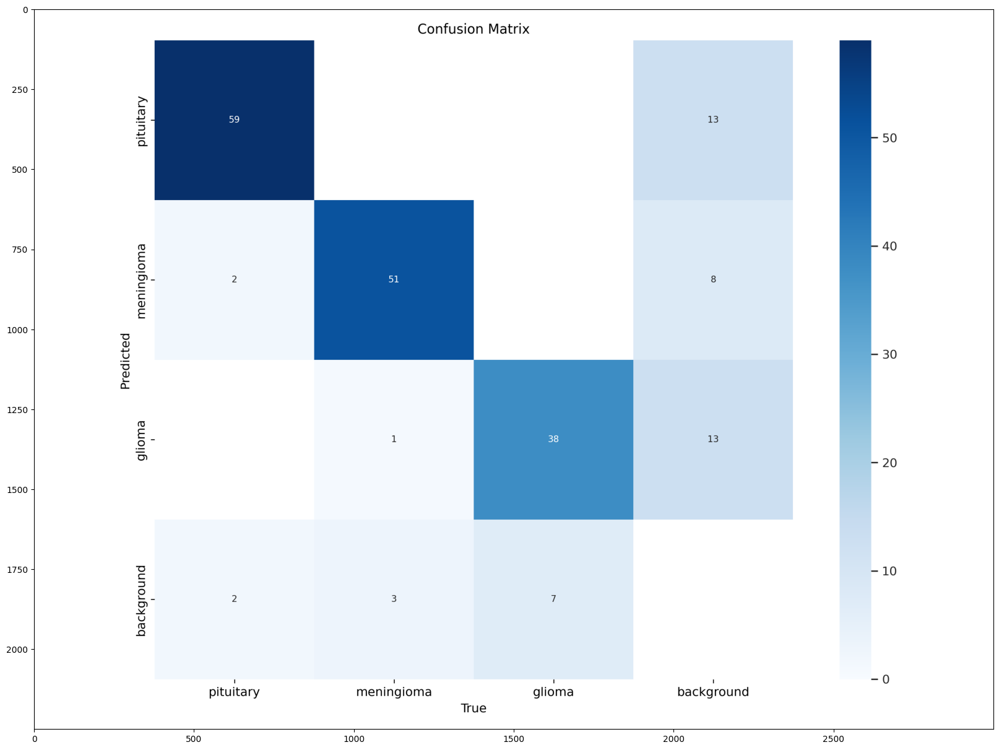

...

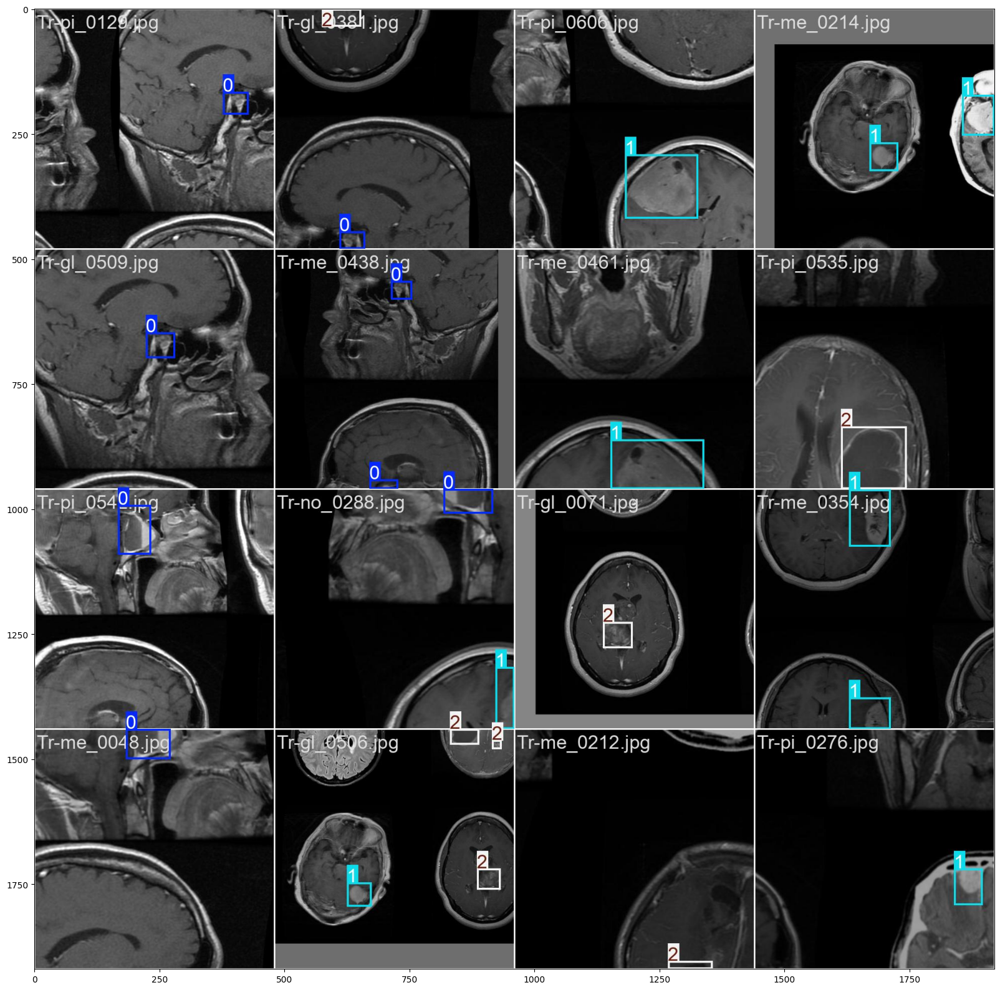

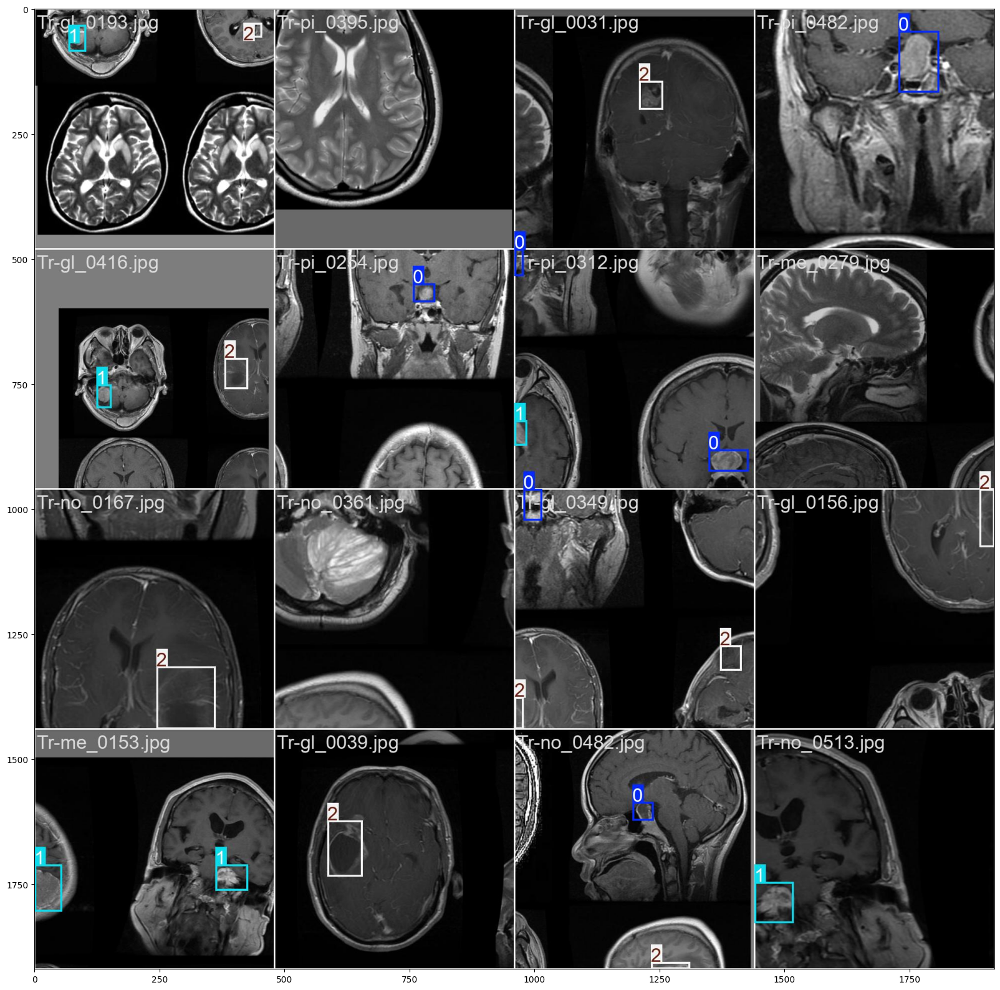

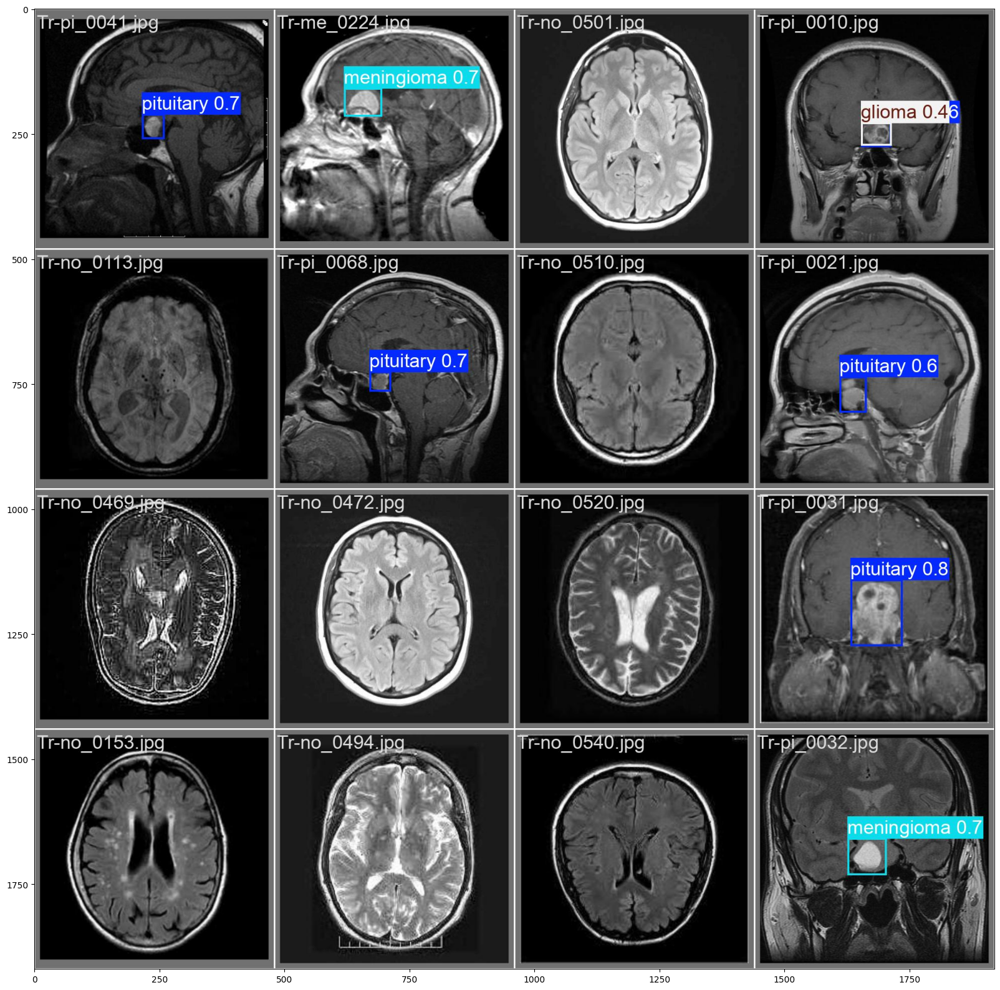

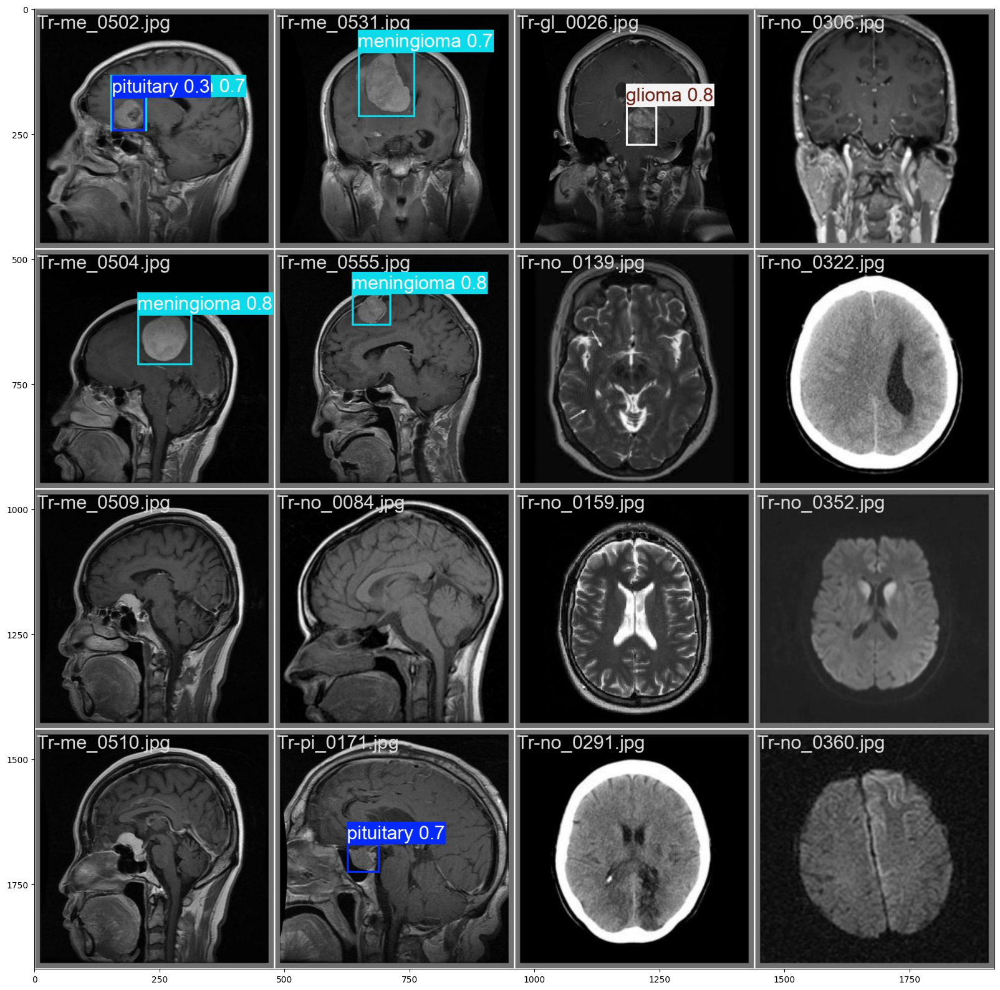

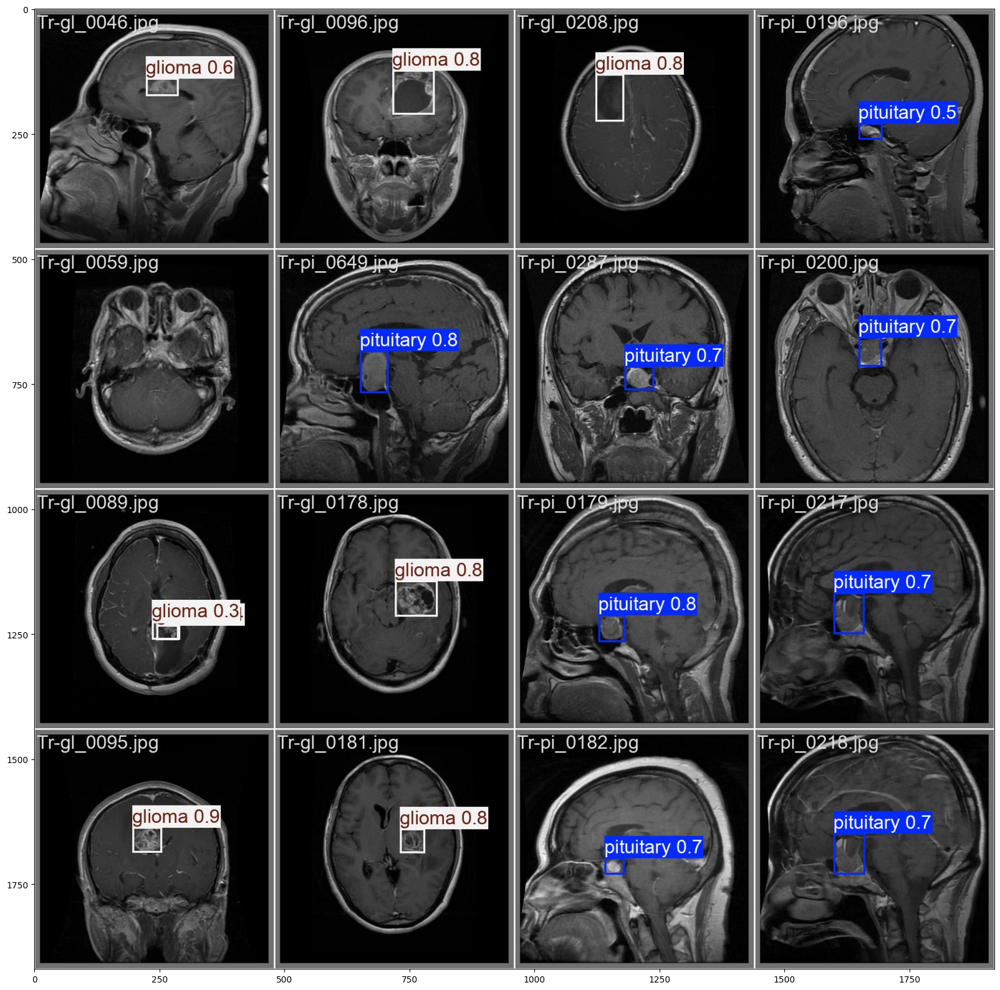

In [6]:
for path in sorted(glob.glob('/kaggle/working/runs/detect/train/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/runs/detect/train/*.jpg')):
    if not path.split('.')[0].endswith('_labels') or path.split('.')[0].startswith('train_'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()

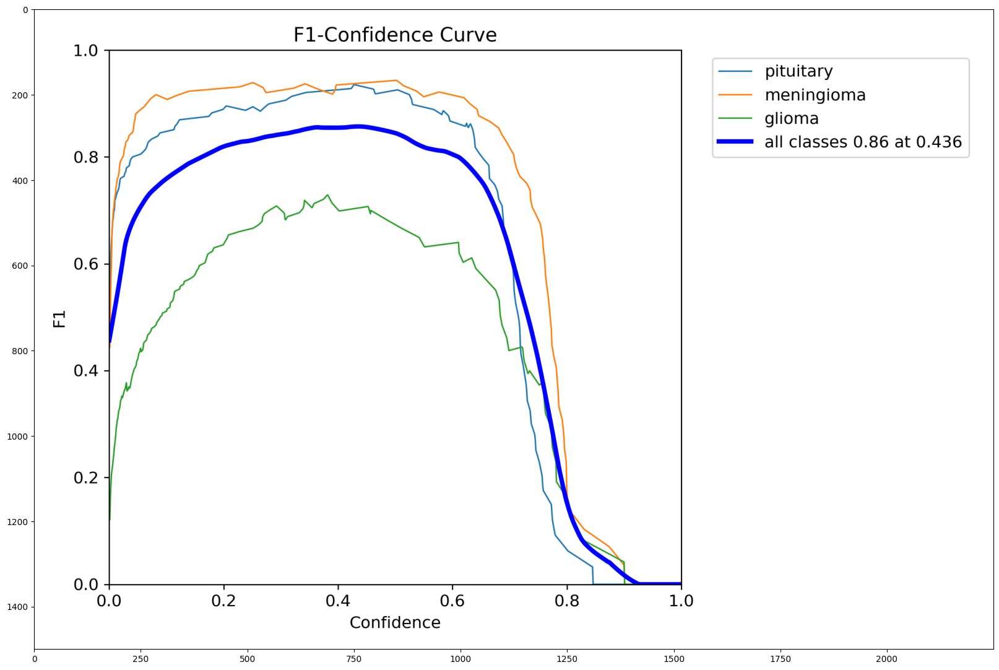

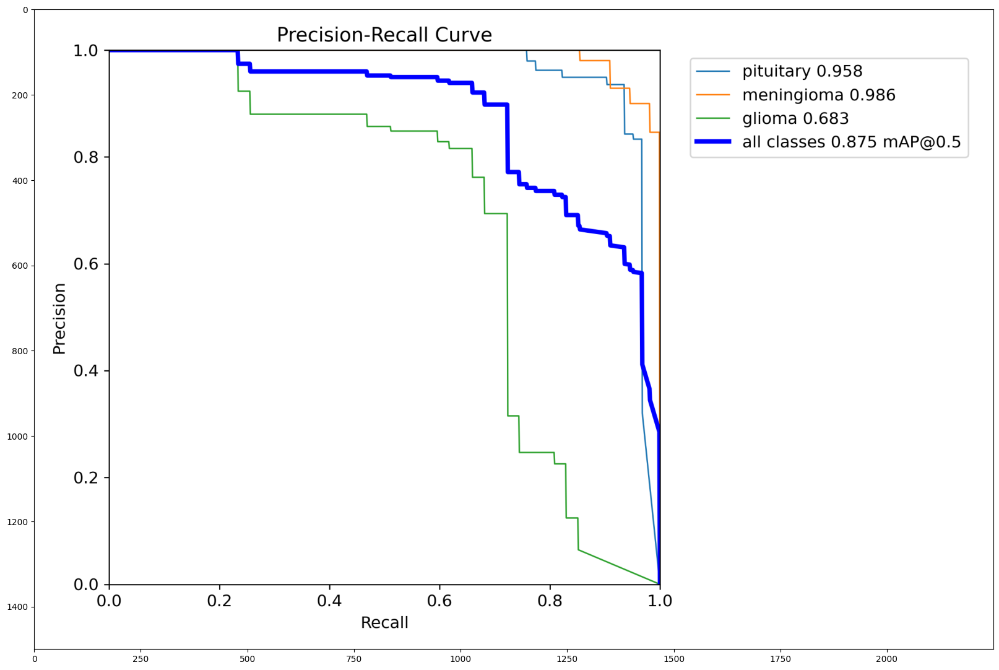

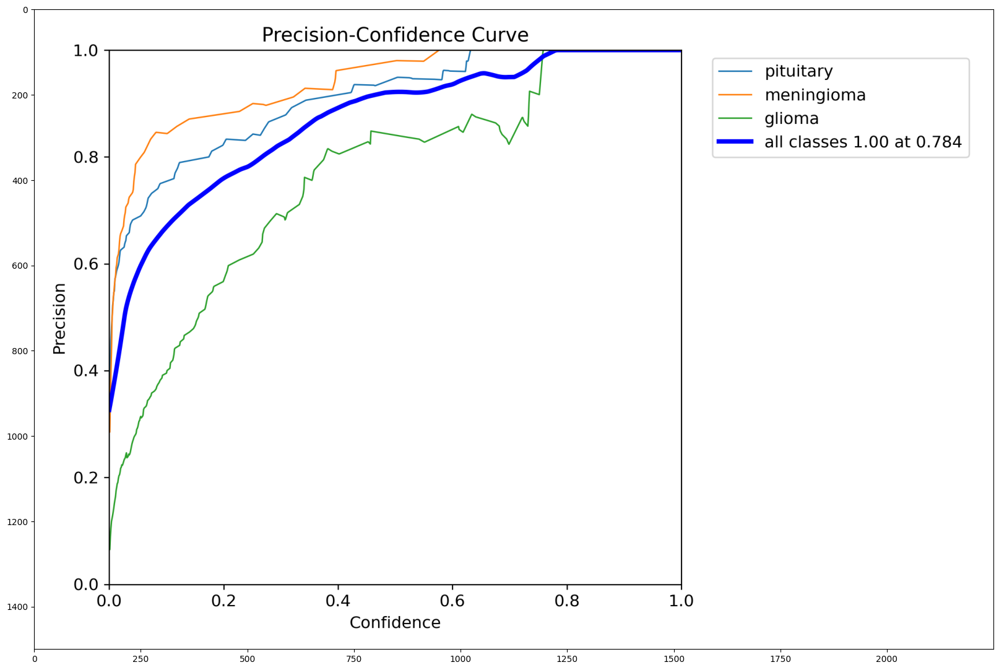

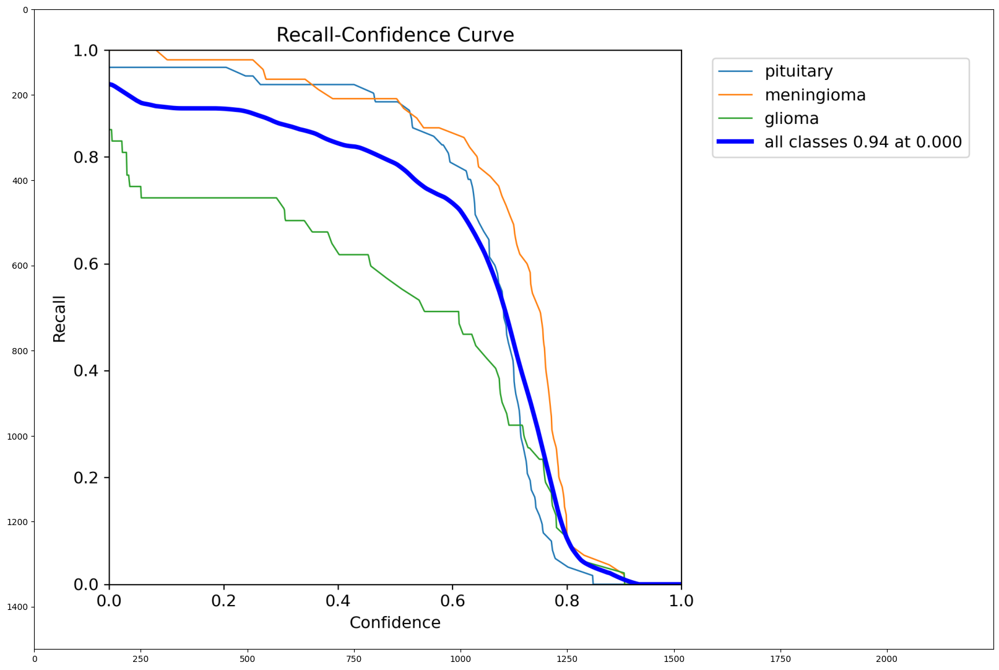

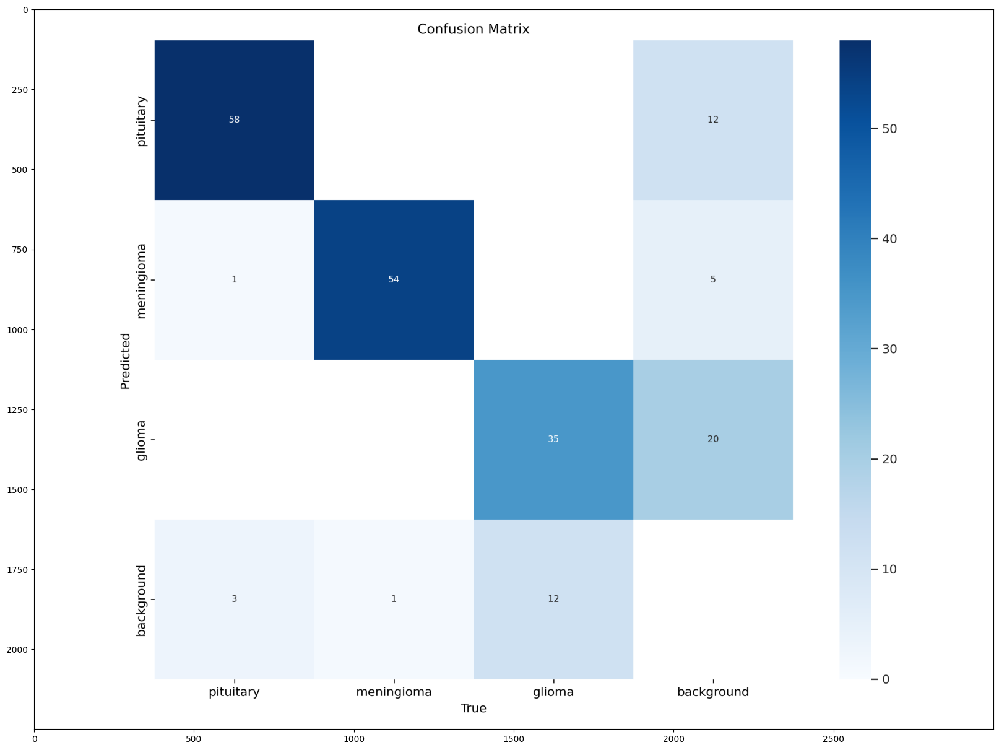

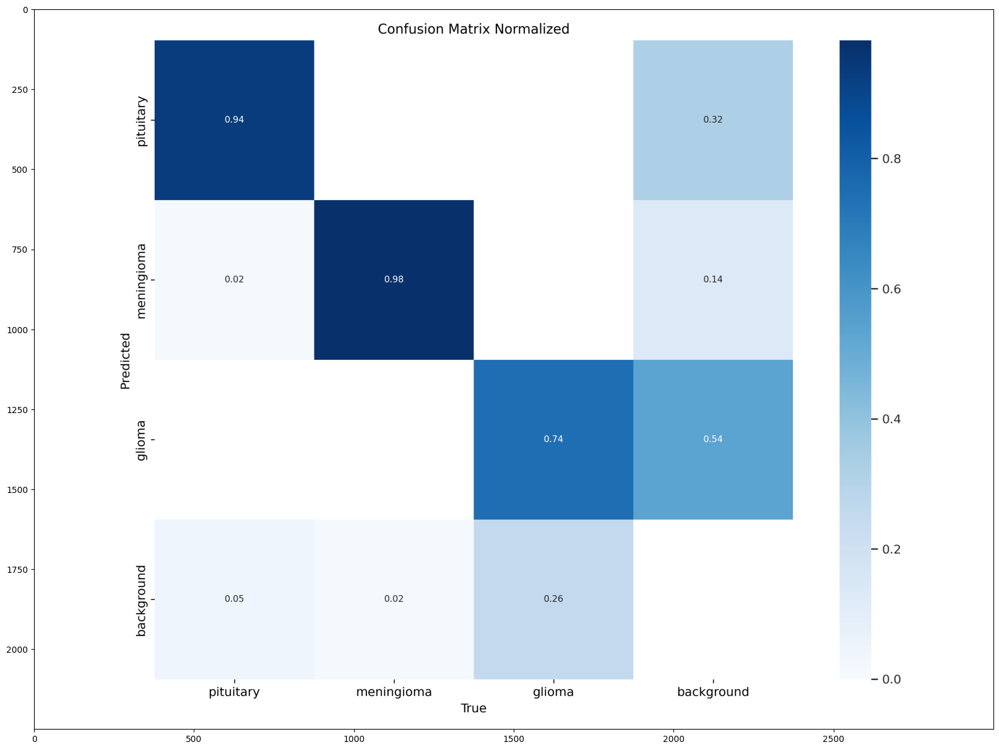

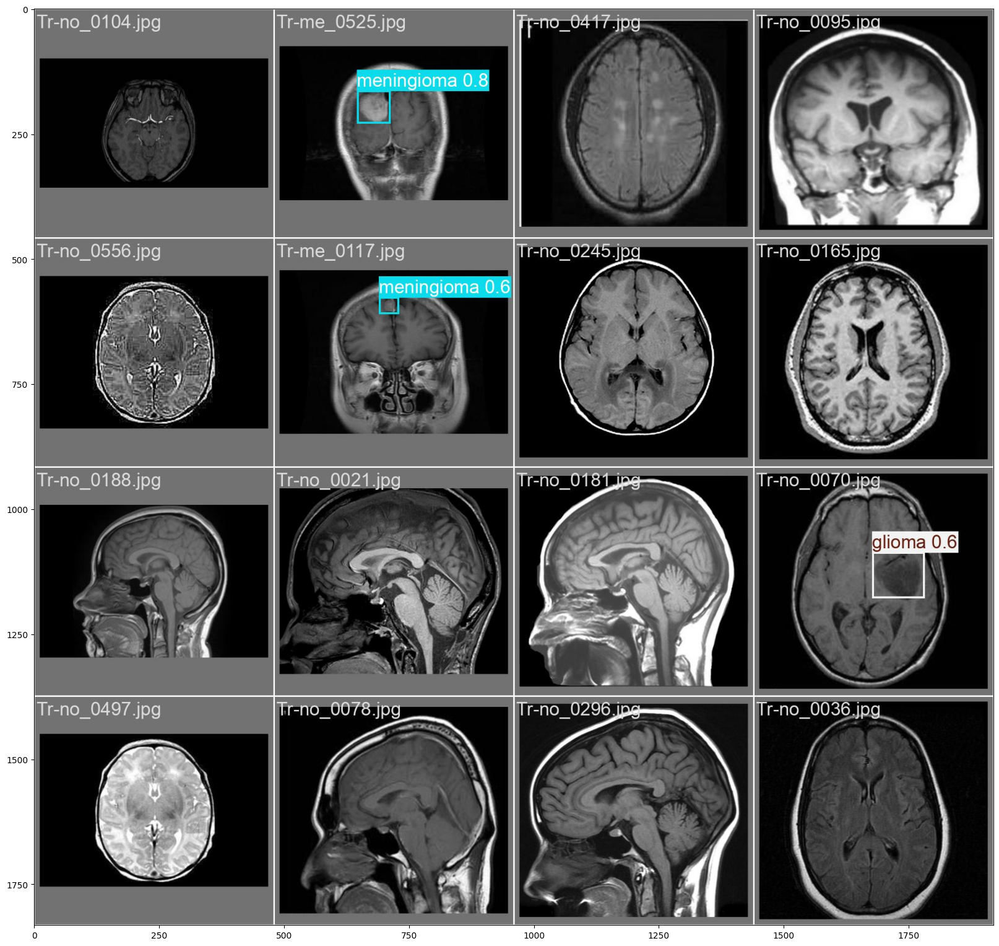

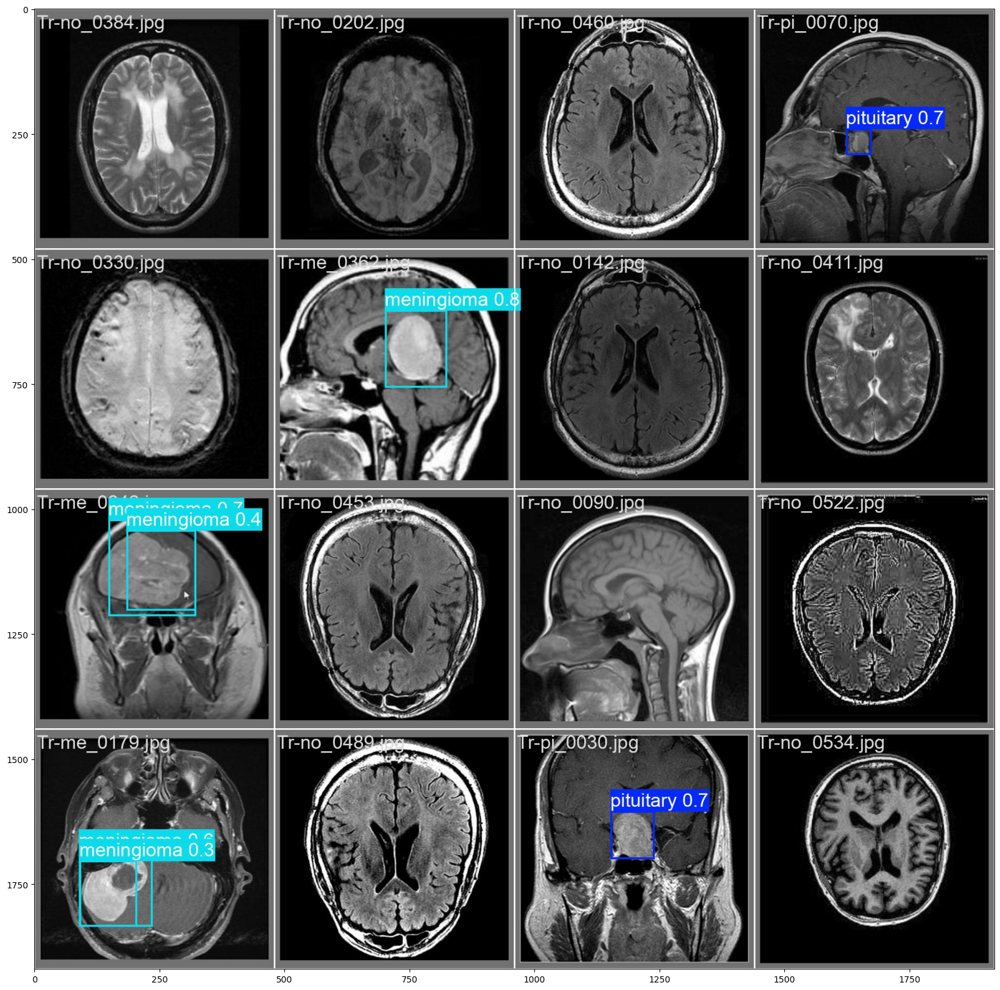

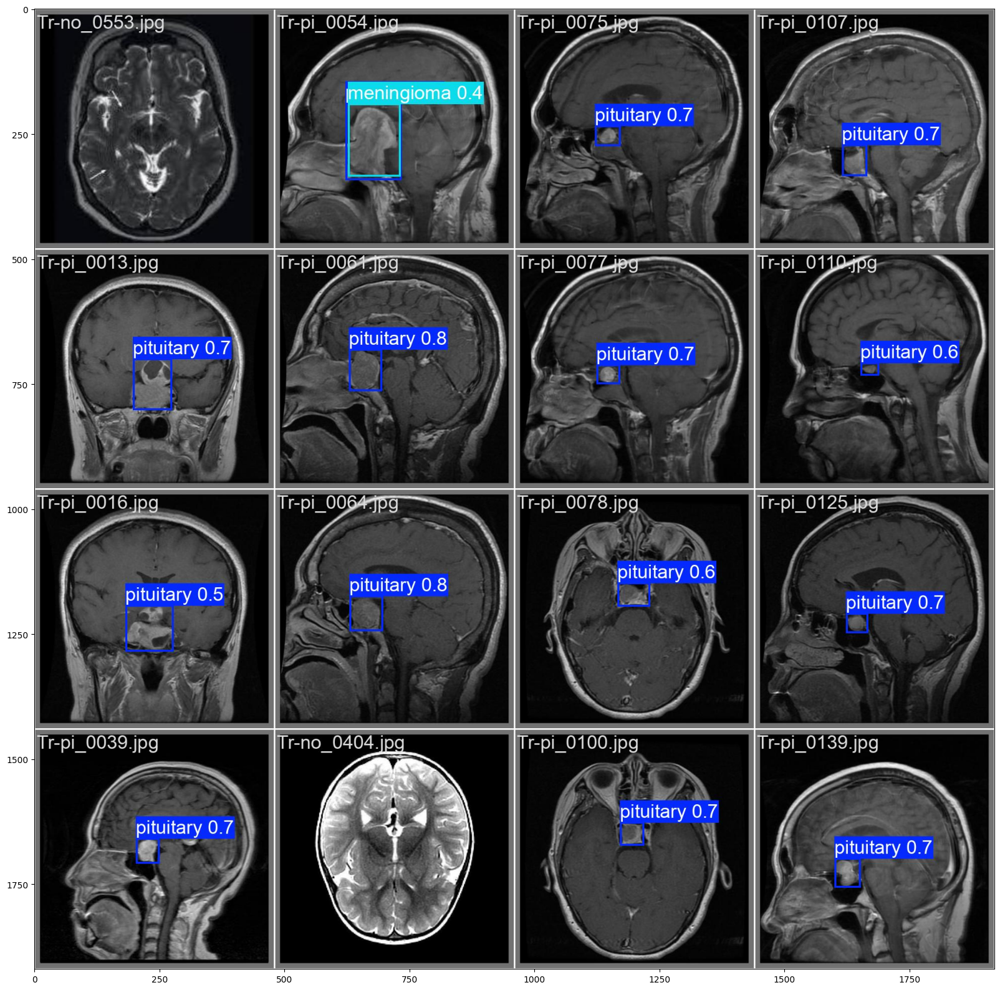

In [7]:
for path in sorted(glob.glob('/kaggle/working/runs/detect/train2/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/runs/detect/train2/*.jpg')):
    if not path.split('.')[0].endswith('_labels'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()